# Transform universal noise

Transform universal noise and see robust it is

In [6]:
%load_ext autoreload
%autoreload 2
# imports
import datetime
import logging
import os
import pathlib
import sys

sys.path.insert(0, os.path.abspath('..'))
sys.path.insert(0, os.path.abspath('../..'))


import cv2
import imutils
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt
from tf_pose.common import CocoPart
from tqdm import tqdm
from PIL import Image

from deepexplain.tf.v1_x import DeepExplain
from plot_utils import plot_pose, plt, plot
from tf_pose import common
from tf_pose.estimator import TfPoseEstimator
from tf_pose.networks import get_graph_path
from utils import load_batch, open_pose_attribution



os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
logging.getLogger("tensorflow").setLevel(logging.CRITICAL)
logging.getLogger('TfPoseEstimatorRun').setLevel(logging.ERROR)
logging.getLogger('DeepExplain').setLevel(logging.ERROR)
logging.getLogger('TfPoseEstimator').setLevel(logging.ERROR)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
# params 432, 368
w, h = 750, 750
image_path_target = '../data/images/rotationTest.jpg'
test_dir = '../data/cocoval2017Humans/test'
model = 'cmu'
log_dir = '../logs/'

resize_out_ratio = 2.0
image_target = common.read_imgfile(image_path_target, w, h)
summary_writer = tf.summary.FileWriter(
    log_dir + "transform/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
test_paths = pathlib.Path(test_dir).glob('*.jpg')
test_paths = sorted([x for x in test_paths])


ATTRIBUTION_PART = CocoPart.RShoulder.value

In [3]:
estimator = TfPoseEstimator(get_graph_path(
    model), target_size=(w, h), trt_bool=False)
upsample_size = [int(estimator.target_size[1] / 8 * resize_out_ratio),
                 int(estimator.target_size[0] / 8 * resize_out_ratio)]
# get all outputs as np matrix
target_np, target_np_heat, target_np_paf, target_np_peaks = estimator.persistent_sess.run(
    [estimator.tensor_output, estimator.tensor_heatMat_up,
        estimator.tensor_pafMat_up, estimator.tensor_peaks],
    feed_dict={
        estimator.tensor_image: [image_target],
        estimator.upsample_size: upsample_size
    }
)

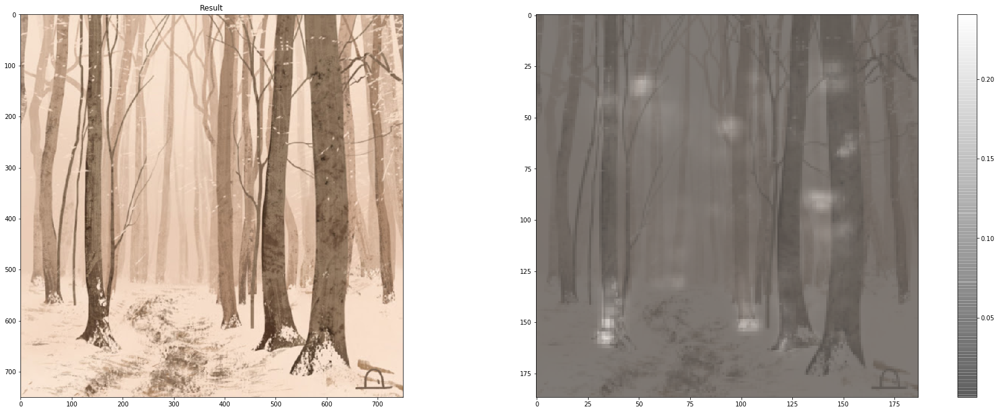

In [4]:
human_target = estimator.inference(
    image_target, resize_to_default=True, upsample_size=resize_out_ratio)
plot_pose(image_target, human_target, estimator.heatMat)

In [5]:
universal_noise = np.load(
    '../snapshots/op_universal_noise_20200205-145237.npy')

In [7]:
print(image_target.shape)
print(universal_noise.shape)

(750, 750, 3)
(368, 432, 3)


/home/ax/miniconda3/envs/masterThesis/lib/python3.6/site-packages/skimage/transform/_warps.py:23: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


Text(0.5, 1.0, 'Heatmap without noise (attr for RShoulder)')

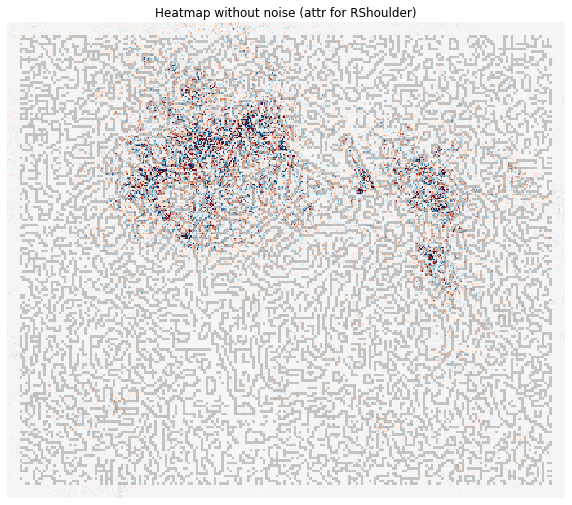

In [8]:
fig = plt.figure(figsize=(10, 10))

attr, _ = open_pose_attribution(estimator, universal_noise, Y_shape = [None] + [1, 46, 54])
ax = fig.add_subplot(1, 1, 1)
plot(attr, xi=universal_noise, axis=ax, 
     dilation=.5, percentile=99, alpha=.2).set_title(
f'Heatmap without noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

# Test Translation

In [10]:
index_list = [(0, 0)]
index_list.append((image_target.shape[0] - universal_noise.shape[0], 0))
index_list.append((0, image_target.shape[1] - universal_noise.shape[1]))
index_list.append((image_target.shape[0] - universal_noise.shape[0],
                   image_target.shape[1] - universal_noise.shape[1]))
index_list.append((200, 200))


0it [00:00, ?it/s]
1it [00:18, 18.33s/it]
2it [00:38, 18.91s/it]
3it [00:59, 19.41s/it]
4it [01:20, 19.93s/it]
5it [01:41, 20.21s/it]


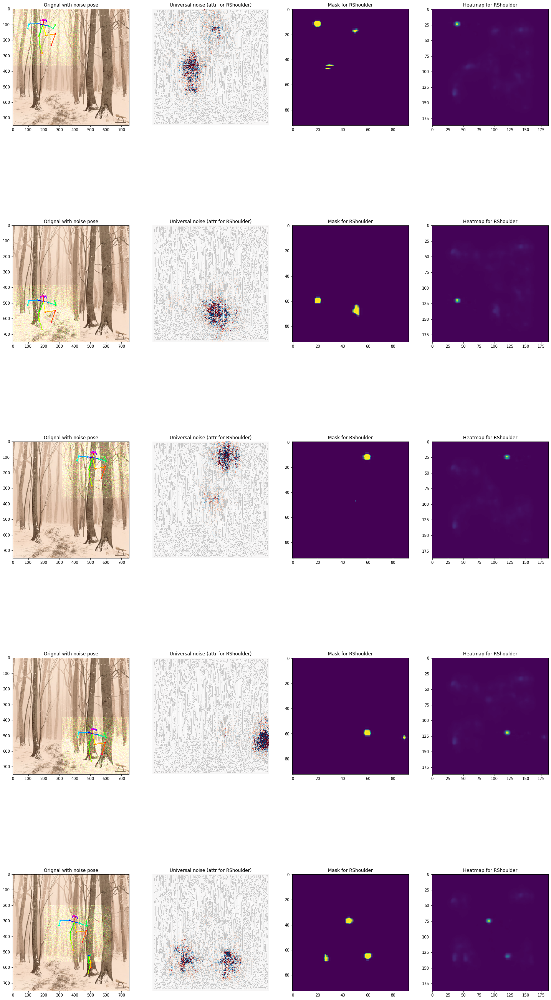

In [21]:
img_cnt = 1
fig = plt.figure(figsize=(25, 50))
PLT_ROWS = 4
for i, (r, c) in tqdm(enumerate(index_list)):
    test_image = np.copy(image_target).astype(np.float64)
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)
    
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)
    
    
    ax = fig.add_subplot(len(index_list), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title('Orignal with noise pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    

    mask_of_mask = np.zeros(test_image.shape[:2])
    mask_of_mask[r:r + universal_noise.shape[0], c:c + universal_noise.shape[1]] = np.ones(universal_noise.shape[:2])
    mask_of_mask = Image.fromarray(np.uint8(mask_of_mask * 255))
    mask_of_mask = np.array(mask_of_mask.resize((93, 93), Image.ANTIALIAS))
    
    ax = fig.add_subplot(len(index_list), PLT_ROWS, img_cnt)
    attr, mask = open_pose_attribution(estimator, test_image, heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART], mask_of_mask=mask_of_mask)
    plot(attr, xi=test_image, axis=ax, 
         dilation=.5, percentile=99, alpha=.2).set_title(
    f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')
    img_cnt += 1
        
    
    ax = fig.add_subplot(len(index_list), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(mask[0, 0, :, :])
    
    ax = fig.add_subplot(len(index_list), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

# Scale

In [22]:
scale_sizes = []
scales = [0.6, 0.75, 0.9, 1.0, 1.5, 1.70]
for scale in scales:
    scale_sizes.append((
        np.ceil(universal_noise.shape[1] * scale).astype(int),
        np.ceil(universal_noise.shape[0] * scale).astype(int)
    ))
print(scale_sizes)

[(260, 221), (324, 276), (389, 332), (432, 368), (648, 552), (735, 626)]



0it [00:00, ?it/s]
1it [00:16, 16.61s/it]
2it [00:34, 16.96s/it]
3it [00:53, 17.46s/it]
4it [01:13, 18.33s/it]
5it [01:33, 18.78s/it]
6it [01:53, 18.96s/it]


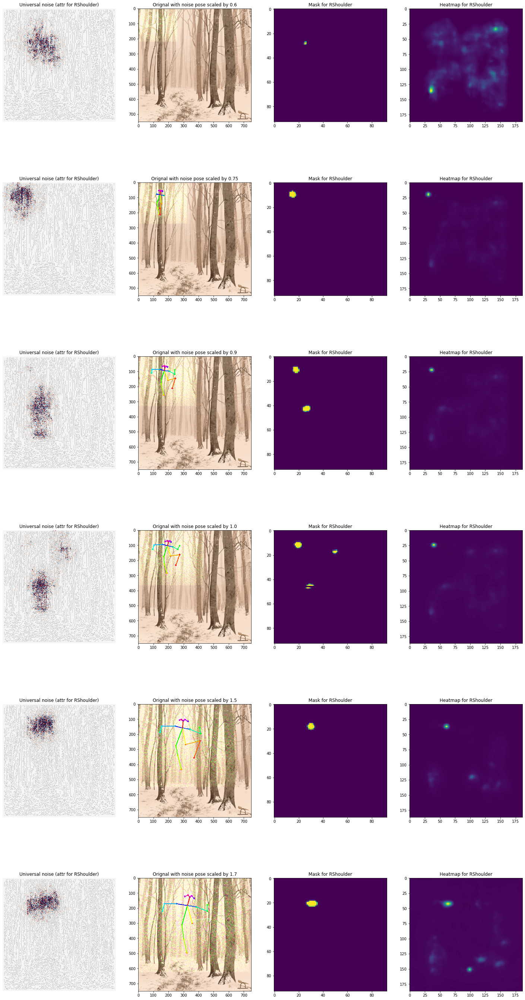

In [25]:
img_cnt = 1
fig = plt.figure(figsize=(25, 50))
for i, (width, height) in tqdm(enumerate(scale_sizes)):
    test_image = np.copy(image_target).astype(np.float64)

    cur_universal_noise = np.copy(universal_noise)
    cur_universal_noise = cv2.resize(cur_universal_noise, (width, height))
    r = 0
    c = 0
    test_image[r:r + cur_universal_noise.shape[0], c:c +
               cur_universal_noise.shape[1]] += cur_universal_noise
    test_image = np.clip(test_image, 0, 255)

    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)
    
    mask_of_mask = np.zeros(test_image.shape[:2])
    mask_of_mask[r:r + universal_noise.shape[0], c:c + universal_noise.shape[1]] = np.ones(universal_noise.shape[:2])
    mask_of_mask = Image.fromarray(np.uint8(mask_of_mask * 255))
    mask_of_mask = np.array(mask_of_mask.resize((93, 93), Image.ANTIALIAS))

    ax = fig.add_subplot(len(scale_sizes), PLT_ROWS, img_cnt)
    img_cnt += 1
    attr, mask = open_pose_attribution(estimator, test_image, heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART], mask_of_mask=mask_of_mask)
    plot(attr, xi=test_image, axis=ax, 
         dilation=.5, percentile=99, alpha=.2).set_title(
    f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

    ax = fig.add_subplot(len(scale_sizes), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Orignal with noise pose scaled by {scales[i]}')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    
    ax = fig.add_subplot(len(scale_sizes), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(mask[0, 0, :, :])
    
    ax = fig.add_subplot(len(scale_sizes), PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

# Rotation


100%|██████████| 24/24 [13:19<00:00, 33.33s/it]


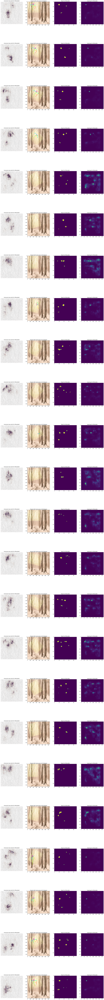

In [27]:
img_cnt = 1
fig = plt.figure(figsize=(25, 250))
degree_steps = 15
rotation_cnt = 360 / degree_steps
for angle in tqdm(range(0, 360, degree_steps)):
    test_image = np.copy(image_target).astype(np.float64)

    cur_universal_noise = np.copy(universal_noise)
    cur_universal_noise = imutils.rotate_bound(cur_universal_noise, angle)
    r = 0
    c = 0
    test_image[r:r + cur_universal_noise.shape[0], c:c +
               cur_universal_noise.shape[1]] += cur_universal_noise
    test_image = np.clip(test_image, 0, 255)

    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)
    
    mask_of_mask = np.zeros(test_image.shape[:2])
    cur_mask_of_mask = np.ones(universal_noise.shape[:2])
    cur_mask_of_mask = imutils.rotate_bound(cur_mask_of_mask, angle)
    mask_of_mask[r:r + cur_mask_of_mask.shape[0], c:c + cur_mask_of_mask.shape[1]] = cur_mask_of_mask
    mask_of_mask = Image.fromarray(np.uint8(mask_of_mask * 255))
    mask_of_mask = np.array(mask_of_mask.resize((93, 93), Image.ANTIALIAS))

    ax = fig.add_subplot(rotation_cnt, PLT_ROWS, img_cnt)
    img_cnt += 1
    attr, mask = open_pose_attribution(
        estimator, 
        test_image, 
        heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART], 
        mask_of_mask=mask_of_mask)
    plot(attr, xi=test_image, axis=ax, 
         dilation=.5, percentile=99, alpha=.2).set_title(
    f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

    ax = fig.add_subplot(rotation_cnt, PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Orignal with noise pose at {angle} degree')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    
    ax = fig.add_subplot(rotation_cnt, PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(mask[0, 0, :, :])
    
    ax = fig.add_subplot(rotation_cnt, PLT_ROWS, img_cnt)
    img_cnt += 1
    ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
    plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

# Multiple

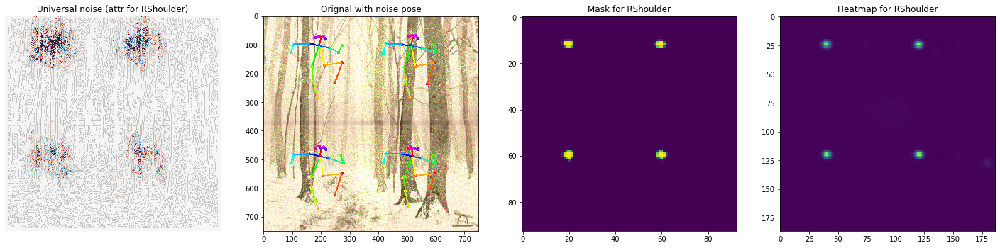

In [26]:
img_cnt = 1

index_list = [(0, 0)]
index_list.append((image_target.shape[0] - universal_noise.shape[0], 0))
index_list.append((0, image_target.shape[1] - universal_noise.shape[1]))
index_list.append((image_target.shape[0] - universal_noise.shape[0],
                   image_target.shape[1] - universal_noise.shape[1]))

fig = plt.figure(figsize=(25, 50))
test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
attr, mask = open_pose_attribution(estimator, test_image, heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART])
plot(attr, xi=test_image, axis=ax, 
     dilation=.5, percentile=99, alpha=.2).set_title(
f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
plt.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(mask[0, 0, :, :])


ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

/home/ax/miniconda3/envs/masterThesis/lib/python3.6/site-packages/skimage/transform/_warps.py:23: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '


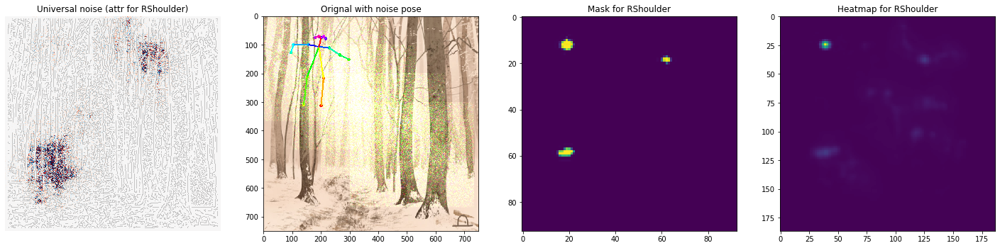

In [27]:
img_cnt = 1

index_list = [(0, 0)]
index_list.append((100, 100))
index_list.append((200, 200))
index_list.append((300, 300))

fig = plt.figure(figsize=(25, 50))
test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
attr, mask = open_pose_attribution(estimator, test_image, heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART])
plot(attr, xi=test_image, axis=ax, 
     dilation=.5, percentile=99, alpha=.2).set_title(
f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
plt.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(mask[0, 0, :, :])


ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

# FOREGROUND extraction

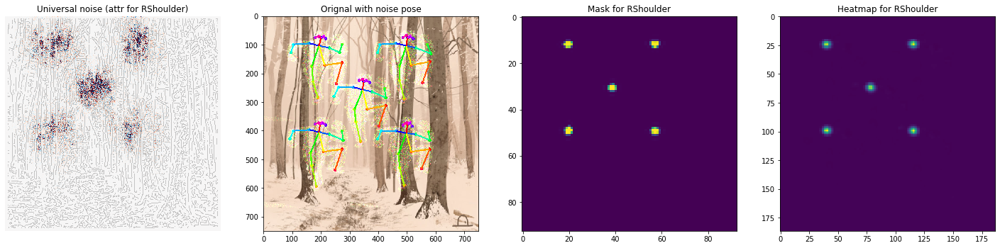

In [28]:
index_list = [(0, 0)]
index_list.append((150, 150))
index_list.append((0, 300))
index_list.append((300, 0))
index_list.append((300, 300))

image_path_source_mask = '../data/images/dri_target_far_2_mask.jpg'

img_cnt = 1

mask = common.read_imgfile(image_path_source_mask,
                           432, 368, cv2.IMREAD_GRAYSCALE) > 0

test_image = np.copy(image_target).astype(np.float64)
for (r, c) in index_list:
    test_image[r:r + universal_noise.shape[0], c:c +
               universal_noise.shape[1]] += universal_noise * mask[..., None]
    test_image = np.clip(test_image, 0, 255)

detections_uni = estimator.inference(
    test_image, resize_to_default=True, upsample_size=resize_out_ratio)
detections_uni = TfPoseEstimator.draw_humans(
    test_image, detections_uni, imgcopy=True)
fig = plt.figure(figsize=(25, 50))

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
attr, mask = open_pose_attribution(estimator, test_image, heatmap=estimator.heatMat[:,:, ATTRIBUTION_PART])
plot(attr, xi=test_image, axis=ax, 
     dilation=.5, percentile=99, alpha=.2).set_title(
f'Universal noise (attr for {CocoPart(ATTRIBUTION_PART).name})')

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title('Orignal with noise pose')
plt.imshow(cv2.cvtColor(detections_uni.astype(
    np.float32) / 255.0, cv2.COLOR_BGR2RGB))

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Mask for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(mask[0, 0, :, :])

ax = fig.add_subplot(1, PLT_ROWS, img_cnt)
img_cnt += 1
ax.set_title(f'Heatmap for {CocoPart(ATTRIBUTION_PART).name}')
plt.imshow(estimator.heatMat[:,:, ATTRIBUTION_PART])

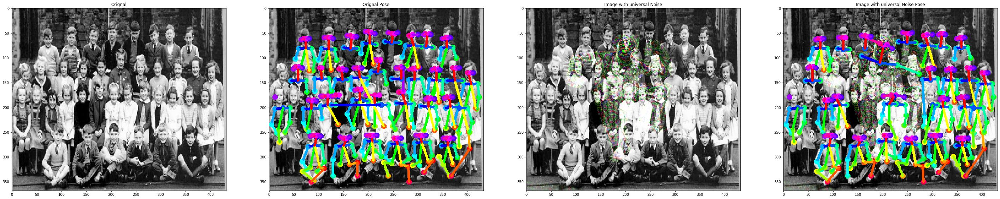

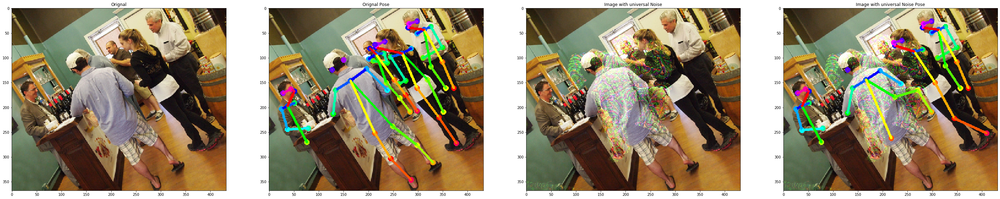

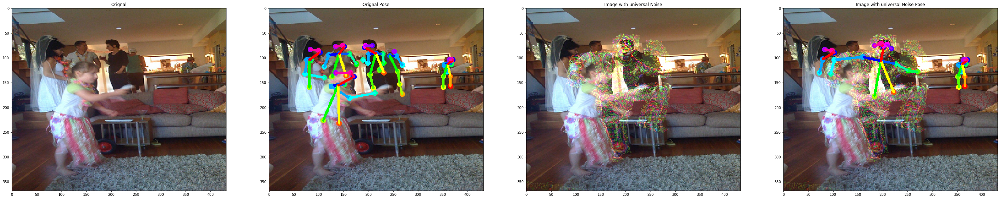

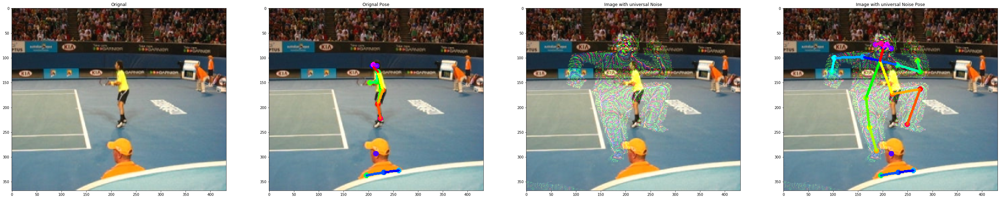

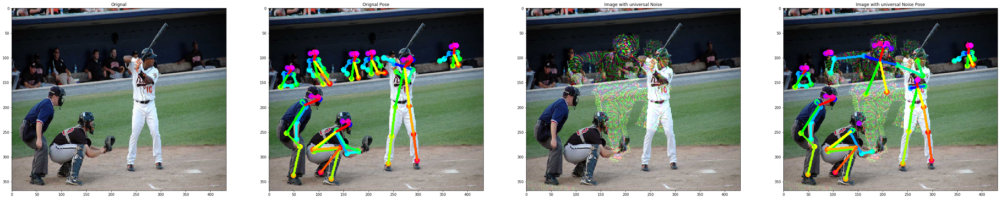

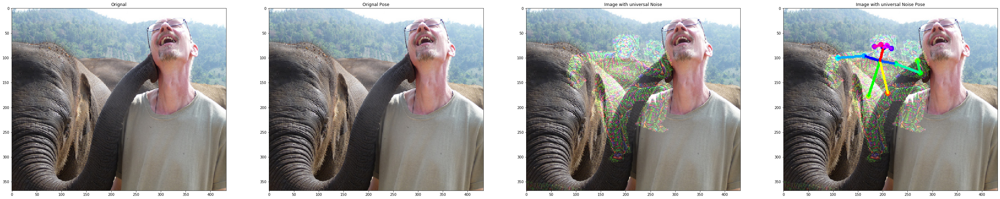

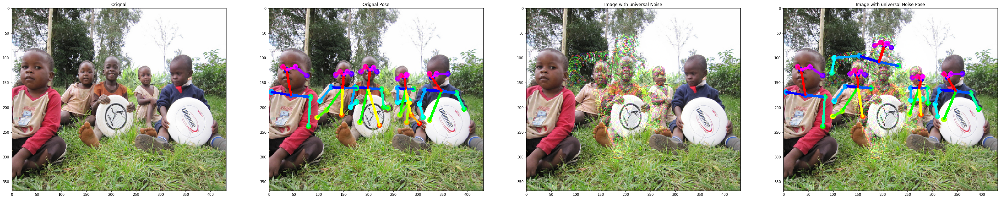

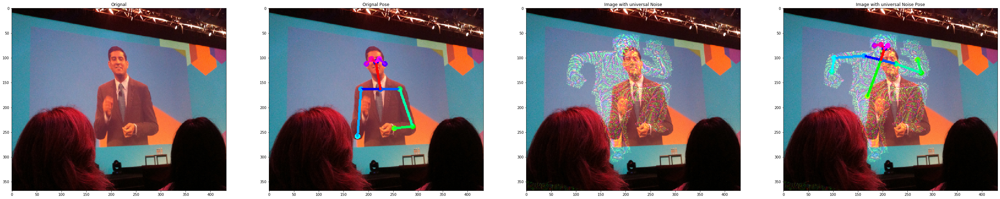

In [15]:
BATCH_SIZE = 8
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)


for i, image in enumerate(batch):
    test_image = np.clip(image + (universal_noise * mask[..., None]), 0, 255)
    detections = estimator.inference(
        image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)

    detections_result = TfPoseEstimator.draw_humans(
        image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose')
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise')
    plt.imshow(cv2.cvtColor(test_image.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

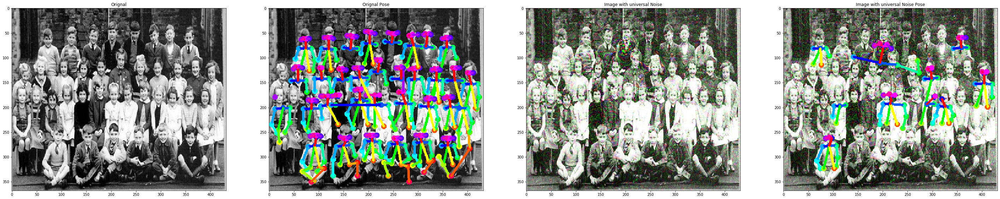

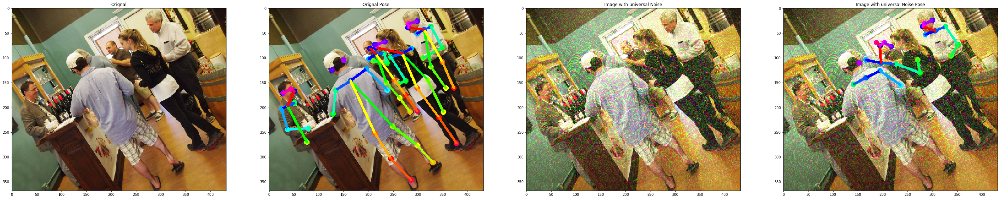

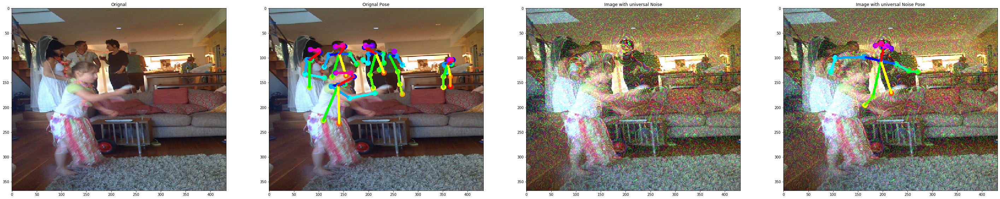

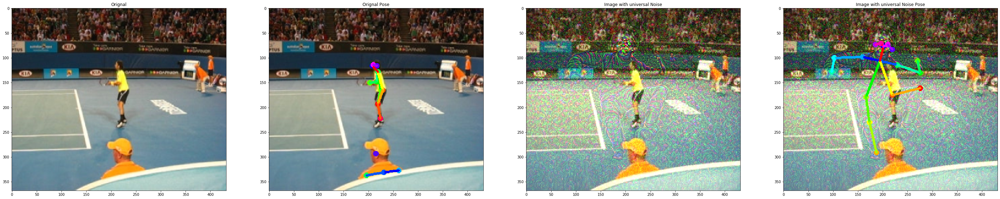

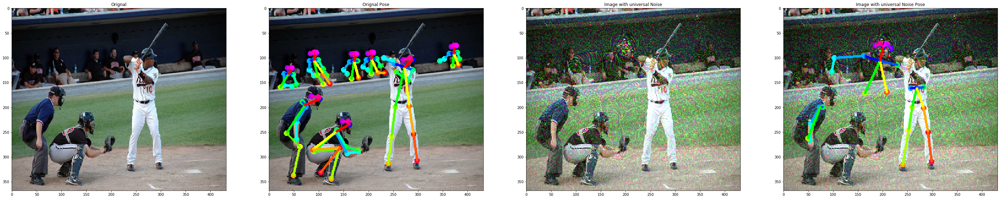

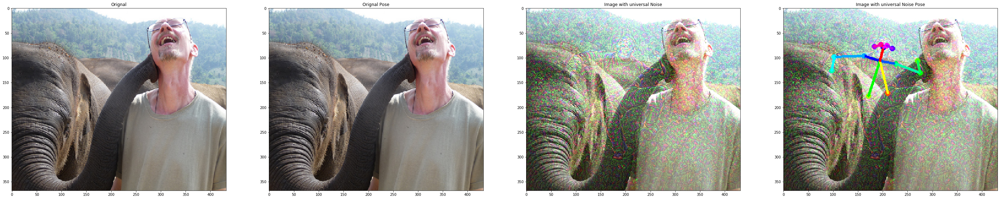

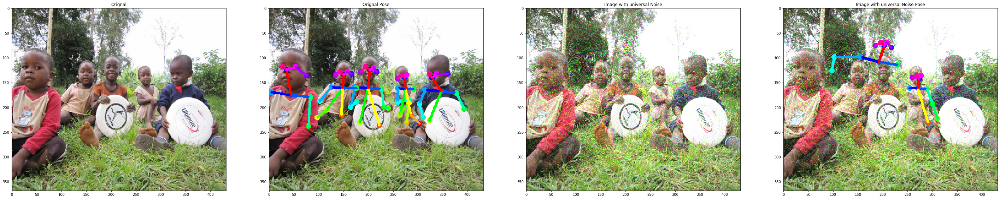

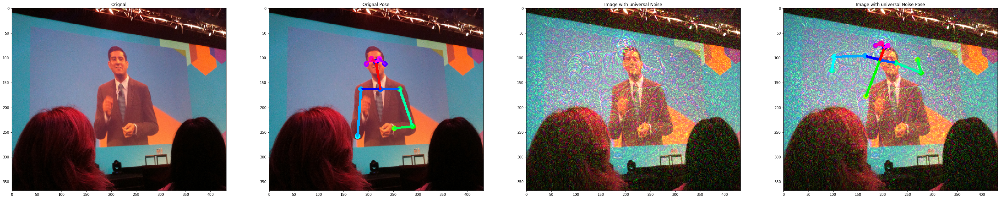

In [16]:
BATCH_SIZE = 8
batch, batch_index = load_batch(test_paths, 0, BATCH_SIZE)


for i, image in enumerate(batch):
    test_image = np.clip(image + (universal_noise), 0, 255)
    detections = estimator.inference(
        image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)

    detections_result = TfPoseEstimator.draw_humans(
        image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose')
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise')
    plt.imshow(cv2.cvtColor(test_image.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose')
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))